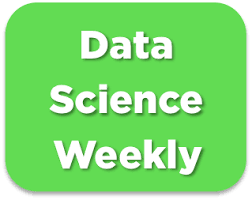

# Challenge : predict conversions 🏆🏆

This is the template that shows the different steps of the challenge. In this notebook, all the training/predictions steps are implemented for a very basic model (logistic regression with only one variable). Please use this template and feel free to change the preprocessing/training steps to get the model with the best f1-score ! May the force be with you 🧨🧨  

**For a detailed description of this project, please refer to *02-Conversion_rate_challenge.ipynb*.**

# Import libraries

In [1]:
import pandas as pd

import plotly.express as px
import plotly.graph_objects as go

from IPython.display import display

In [2]:
# Constants
GRAPH_HEIGHT = 400
GRAPH_WIDTH = 800
PLOTLY_SIZE_PARAMETERS = {'width': GRAPH_WIDTH, 'height': GRAPH_HEIGHT}

# Read file with labels

In [3]:
data = pd.read_csv('../data/raw/conversion_data_train.csv')
print('Set with labels (our train+test) :', data.shape)

Set with labels (our train+test) : (284580, 6)


In [4]:
data.head()

,country,age,new_user,source,total_pages_visited,converted
0,China,22,1,Direct,2,0
1,UK,21,1,Ads,3,0
2,Germany,20,0,Seo,14,1
3,US,23,1,Seo,3,0
4,US,28,1,Direct,3,0


In [5]:
#age tranche d'age
#new user source

# Explore dataset

## Observation & Data Quality

* No Missing Values: Excellent! The "Percentage of missing values" section shows 0.0 for all columns, indicating a complete dataset. This is a great starting point for analysis.
* Mixed Data Types:
  * country and source appear to be categorical (object/string type).
  * age, new_user, and total_pages_visited appear to be numerical. new_user specifically looks like a binary numerical variable (0 or 1).

## Basic Statistics Breakdown:

Let's break down the basic statistics for each column:

* `country`
  * Unique: 4 unique countries.
  * Top: 'US' is the most frequent country.
  * Freq: The US is the dominant country in the dataset, accounting for approximately 160124/284580≈56.27% of the observations.
* `age`
  * Mean: The average age of users is approximately 30.56 years.
  * Std (Standard Deviation): The age distribution has a standard deviation of about 8.27 years.
  * Min: The youngest user is 17 years old.
  * Max: **The oldest user is now 123 years old**. This maximum value (123) is quite high and might indicate a data entry error or an outlier. It's worth investigating if ages above a certain reasonable human lifespan (e.g., 90-100) should be considered valid or potentially capped/removed.
* `new_user`
  * Mean: The average new_user value is approximately 0.6855. This means about 68.55% of your observations are from new users, consistent with the previous data.
  * Min: 0 (existing user).
  * Max: 1 (new user).
* `total_pages_visited`
  * Mean: Users visit an average of approximately 4.87 pages.
  * Min: Some users visit only 1 page.
  * 25% (Q1): 25% of users visit 2 pages or fewer.
  * 50% (Median): The median number of pages visited is 4.
  * 75% (Q3): 75% of users visit 7 pages or fewer.
  * Max: The maximum number of pages visited is 29.
* `converted`
  * Mean: The average converted value is approximately 0.032258. Since converted is likely a binary variable (0 for not converted, 1 for converted), this mean represents the conversion rate. So, about 3.23% of your users have converted. This is a key metric!
  * Std: The standard deviation is about 0.1767.
  * Min: 0 (not converted).
  * Max: 1 (converted).

## Overall Summary & Potential Next Steps

* Data Integrity: No missing values, which is excellent.
* Age Outlier: The max age of 123 needs attention. 
  * Investigate: Are these valid data points (e.g., extremely rare cases) or data entry errors?
  * Cap/Remove: If they are errors, I might cap the age at a more realistic maximum (e.g., 90-100) or remove these rows if they are few.
* Key Metric: 
  * Conversion Rate: The converted column is very important. **You have a conversion rate of approximately 3.23%**. This is the primary target variable (**It will be important to distribute the target for the training**).

In [6]:
print(f'Number of rows: {data.shape[0]}')
print('Display of dataset')
display(data.head())
print('Basic statistics')
display(data.describe(include='all'))
print('Percentage of missing values')
display(data.isna().sum()/data.shape[0]*100)

Number of rows: 284580
Display of dataset


,country,age,new_user,source,total_pages_visited,converted
0,China,22,1,Direct,2,0
1,UK,21,1,Ads,3,0
2,Germany,20,0,Seo,14,1
3,US,23,1,Seo,3,0
4,US,28,1,Direct,3,0


Basic statistics


,country,age,new_user,source,total_pages_visited,converted
count,284580,284580.000000,284580.000000,284580,284580.000000,284580.000000
unique,4,NaN,NaN,3,NaN,NaN
top,US,NaN,NaN,Seo,NaN,NaN
freq,160124,NaN,NaN,139477,NaN,NaN
mean,NaN,30.564203,0.685452,NaN,4.873252,0.032258
std,NaN,8.266789,0.464336,NaN,3.341995,0.176685
min,NaN,17.000000,0.000000,NaN,1.000000,0.000000
25%,NaN,24.000000,0.000000,NaN,2.000000,0.000000
50%,NaN,30.000000,1.000000,NaN,4.000000,0.000000
75%,NaN,36.000000,1.000000,NaN,7.000000,0.000000


Percentage of missing values


country                0.0
age                    0.0
new_user               0.0
source                 0.0
total_pages_visited    0.0
converted              0.0
dtype: float64

## Deep dive with graphics

### Investigation Age Outlier

Let's use the Three Sigma Rule (also known as the 68-95-99.7 rule) states that for a normally distributed dataset:
  * Approximately 68% of the data falls within ±1 standard deviation of the mean.
  * Approximately 95% of the data falls within ±2 standard deviations of the mean.
  * Approximately 99.7% of the data falls within ±3 standard deviations of the mean.

With the Three Sigma Rule, it includes all users in the dataset whose age is either:
  * Greater than 55.36 years old
  * Less than 5.76 years old

These users are considered outliers according to the three-sigma rule, assuming the age distribution is roughly normal.

In [7]:
px.histogram(data, x='age', **PLOTLY_SIZE_PARAMETERS)

In [8]:
px.box(data, x='country', y='age', **PLOTLY_SIZE_PARAMETERS)

Let's see how many outliers (with the Three Sigma Rule), the dataset includes for the age.
 

In [9]:
upper_bound_outlier = data["age"].mean() + 3*data["age"].std()
lower_bound_outlier = data["age"].mean() - 3*data["age"].std()
data_age_outliers = data[(data['age'] > upper_bound_outlier) | (data['age'] < lower_bound_outlier)]
print('Sample of the age outliers')
display(data_age_outliers.head())
print(f'Percentage of outliers in the data set {round(data_age_outliers.shape[0] / data.shape[0] * 100, 2)}%')

Sample of the age outliers


,country,age,new_user,source,total_pages_visited,converted
55,US,62,1,Seo,4,0
296,China,58,1,Ads,6,0
731,China,57,1,Seo,11,0
965,US,56,1,Seo,2,0
1014,US,61,1,Seo,7,0


Percentage of outliers in the data set 0.36%


Let's remove only the ages over 100 years as it is probably be some errors in the data set.

In [10]:
data = data[data['age'] < 100]  

The age distribution of the users.

In [11]:
px.histogram(data, x='age', **PLOTLY_SIZE_PARAMETERS)

### Population of converted users

In [12]:
df_counts = data['new_user'].value_counts().reset_index()
df_counts.columns = ['new_user', 'count']
df_counts['new_user'] = df_counts['new_user'].map({0: 'Not Converted', 1: 'Converted'})

fig = px.pie(df_counts, names='new_user', values='count', title='Population of converted users', **PLOTLY_SIZE_PARAMETERS)
fig.show()

### Population of users per Country

In [13]:
df_counts = data['country'].value_counts().reset_index()
df_counts.columns = ['country', 'count']
fig = px.pie(df_counts, names='country', values='count', title='Population of users per Country', **PLOTLY_SIZE_PARAMETERS)
fig.show()

### Population of users per Source

In [14]:
df_counts = data['source'].value_counts().reset_index()
df_counts.columns = ['source', 'count']
fig = px.pie(df_counts, names='source', values='count', title='Population of users per Source', **PLOTLY_SIZE_PARAMETERS)
fig.show()

In [15]:
px.histogram(data, x='source', y='converted', histnorm='percent', **PLOTLY_SIZE_PARAMETERS)

### The users according to their age

In [16]:
fig = px.histogram(data, x='age', color='country', **PLOTLY_SIZE_PARAMETERS)
fig.show()

In [17]:
ordered_countries = sorted(data['country'].unique(), reverse=True)

fig = px.histogram(
    data,
    x='age',
    y='converted',
    color='country',
    nbins=15,
    category_orders={'country': ordered_countries},
    **PLOTLY_SIZE_PARAMETERS
)

fig.show()

### The users according to the total page visited

In [18]:
fig = px.histogram(data, x='total_pages_visited', color='country', **PLOTLY_SIZE_PARAMETERS)
fig.show()

In [19]:
px.histogram(data, x='total_pages_visited', y='converted', histnorm='percent', **PLOTLY_SIZE_PARAMETERS)

### Bivariate analysis

In [20]:
fig = px.scatter_matrix(data)

fig.update_layout(
        title = go.layout.Title(text = "Bivariate analysis", x = 0.5), 
        showlegend = False, 
        autosize=False,
        height=800,
        width=1200)
fig.show()

### Correlation matrix

In [21]:
corr_matrix = data.select_dtypes(exclude="object").corr().round(2)

fig = px.imshow(corr_matrix.values,
                x = corr_matrix.columns.tolist(),
                y = corr_matrix.index.tolist(),
                text_auto=True,
                **PLOTLY_SIZE_PARAMETERS)
fig.show()

# Feature engineering

Let's add some new columns

In [22]:
data['total_pages_visited_x2'] = data['total_pages_visited'] ** 2
# data['total_pages_visited_x3'] = data['total_pages_visited'] ** 3
data['total_pages_visited_age'] = data['total_pages_visited'] * data['age']
data['total_pages_visited_age_x2'] = (data['total_pages_visited'] * data['age']) ** 2 
data.head()

,country,age,new_user,source,total_pages_visited,converted,total_pages_visited_x2,total_pages_visited_age,total_pages_visited_age_x2
0,China,22,1,Direct,2,0,4,44,1936
1,UK,21,1,Ads,3,0,9,63,3969
2,Germany,20,0,Seo,14,1,196,280,78400
3,US,23,1,Seo,3,0,9,69,4761
4,US,28,1,Direct,3,0,9,84,7056


In [23]:
# import numpy as np

# data['total_pages_visited_log'] = data['total_pages_visited'].apply(np.log10)
# fig = px.histogram(data, x='total_pages_visited_log', color='country', **PLOTLY_SIZE_PARAMETERS)
# fig.show()

### Correlation matrix

In [24]:
corr_matrix = data.select_dtypes(exclude="object").corr().round(2)

fig = px.imshow(corr_matrix.values,
                x = corr_matrix.columns.tolist(),
                y = corr_matrix.index.tolist(),
                text_auto=True,
                **PLOTLY_SIZE_PARAMETERS)
fig.show()

In [25]:
#data.drop(columns=['total_pages_visited_x2', 'total_pages_visited_age', 'total_pages_visited_age_x2', 'total_pages_visited_log'], inplace=True)

In [26]:
corr_matrix = data.select_dtypes(exclude="object").corr().round(2)

fig = px.imshow(corr_matrix.values,
                x = corr_matrix.columns.tolist(),
                y = corr_matrix.index.tolist(),
                text_auto=True,
                **PLOTLY_SIZE_PARAMETERS)
fig.show()

## Next steps 

* Export the EDA output:
  * without the outliers
  * with the new columns
* Let's train a model and predict the `converted` value

In [27]:
data.to_csv('../data/processed/conversion_data_train_EDA_output.csv')
print('Set with labels (our train+test) :', data.shape)

Set with labels (our train+test) : (284578, 9)
